# Data Analysis

In [ ]:
! pip install pandas-profiling[notebook] --user

In [100]:
# imports
import datetime as dt

import pandas as pd
from matplotlib import pyplot as plt
from pandas_profiling import ProfileReport

In [101]:
pd.options.display.max_columns = None
%matplotlib inline

### Ingest data from the files

In [102]:
# Cities.csv has demographics information about Canadian cities and about urban population.
cities_df = pd.read_csv('./cities.csv')

# Climate.csv has weather information for few cities from weather stations around Canada.
climate_df = pd.read_csv('./climate.csv')

In [103]:
cities_df.head()

,city,lat,lng,country,iso2,admin,capital,population,population_proper
0,Toronto,43.666667,-79.416667,Canada,CA,Ontario,admin,5213000,3934421
1,Montréal,45.500000,-73.583333,Canada,CA,Québec,NaN,3678000,2356556
2,Vancouver,49.250000,-123.133333,Canada,CA,British Columbia,NaN,2313328,603502
3,Ottawa,45.416667,-75.700000,Canada,CA,Ontario,primary,1145000,812129
4,Calgary,51.083333,-114.083333,Canada,CA,Alberta,NaN,1110000,915322


In [104]:
climate_df.head()

,lng,lat,STATION_NAME,CLIMATE_IDENTIFIER,ID,LOCAL_DATE,PROVINCE_CODE,LOCAL_YEAR,LOCAL_MONTH,LOCAL_DAY,MEAN_TEMPERATURE,MEAN_TEMPERATURE_FLAG,MIN_TEMPERATURE,MIN_TEMPERATURE_FLAG,MAX_TEMPERATURE,MAX_TEMPERATURE_FLAG,TOTAL_PRECIPITATION,TOTAL_PRECIPITATION_FLAG,TOTAL_RAIN,TOTAL_RAIN_FLAG,TOTAL_SNOW,TOTAL_SNOW_FLAG,SNOW_ON_GROUND,SNOW_ON_GROUND_FLAG,DIRECTION_MAX_GUST,DIRECTION_MAX_GUST_FLAG,SPEED_MAX_GUST,SPEED_MAX_GUST_FLAG,COOLING_DEGREE_DAYS,COOLING_DEGREE_DAYS_FLAG,HEATING_DEGREE_DAYS,HEATING_DEGREE_DAYS_FLAG,MIN_REL_HUMIDITY,MIN_REL_HUMIDITY_FLAG,MAX_REL_HUMIDITY,MAX_REL_HUMIDITY_FLAG
0,-112.966667,54.283333,ABEE AGDM,3010010,3010010.2020.1.1,2021-01-01 0:00,AB,2021,1,1,-9.2,NaN,-16.4,NaN,-2.1,NaN,NaN,M,NaN,NaN,NaN,M,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,27.2,NaN,86.0,NaN,97.0,NaN
1,-112.966667,54.283333,ABEE AGDM,3010010,3010010.2020.1.2,2021-01-02 0:00,AB,2021,1,2,-7.9,NaN,-14.7,NaN,-1.1,NaN,0.9,NaN,NaN,NaN,NaN,M,NaN,NaN,34.0,NaN,53.0,NaN,0.0,NaN,25.9,NaN,47.0,NaN,99.0,NaN
2,-112.966667,54.283333,ABEE AGDM,3010010,3010010.2020.1.3,2021-01-03 0:00,AB,2021,1,3,-12.0,NaN,-17.8,NaN,-6.2,NaN,NaN,M,NaN,NaN,NaN,M,NaN,NaN,13.0,NaN,37.0,NaN,0.0,NaN,30.0,NaN,77.0,NaN,93.0,NaN
3,-112.966667,54.283333,ABEE AGDM,3010010,3010010.2020.1.4,2021-01-04 0:00,AB,2021,1,4,-5.1,NaN,-10.0,NaN,-0.2,NaN,0.0,NaN,NaN,NaN,NaN,M,NaN,NaN,32.0,NaN,65.0,NaN,0.0,NaN,23.1,NaN,64.0,NaN,92.0,NaN
4,-112.966667,54.283333,ABEE AGDM,3010010,3010010.2020.1.5,2021-01-05 0:00,AB,2021,1,5,-10.6,NaN,-19.6,NaN,-1.5,NaN,NaN,M,NaN,NaN,NaN,M,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,28.6,NaN,57.0,NaN,98.0,NaN


In [105]:
# get the number of rows and columns of a dataframe
print(cities_df.shape)
print(climate_df.shape)

(247, 9)
(41513, 36)


In [106]:
# get the names of columns of a dataframe
print(cities_df.columns)
print(climate_df.columns)

Index(['city', 'lat', 'lng', 'country', 'iso2', 'admin', 'capital',
       'population', 'population_proper'],
      dtype='object')
Index(['lng', 'lat', 'STATION_NAME', 'CLIMATE_IDENTIFIER', 'ID', 'LOCAL_DATE',
       'PROVINCE_CODE', 'LOCAL_YEAR', 'LOCAL_MONTH', 'LOCAL_DAY',
       'MEAN_TEMPERATURE', 'MEAN_TEMPERATURE_FLAG', 'MIN_TEMPERATURE',
       'MIN_TEMPERATURE_FLAG', 'MAX_TEMPERATURE', 'MAX_TEMPERATURE_FLAG',
       'TOTAL_PRECIPITATION', 'TOTAL_PRECIPITATION_FLAG', 'TOTAL_RAIN',
       'TOTAL_RAIN_FLAG', 'TOTAL_SNOW', 'TOTAL_SNOW_FLAG', 'SNOW_ON_GROUND',
       'SNOW_ON_GROUND_FLAG', 'DIRECTION_MAX_GUST', 'DIRECTION_MAX_GUST_FLAG',
       'SPEED_MAX_GUST', 'SPEED_MAX_GUST_FLAG', 'COOLING_DEGREE_DAYS',
       'COOLING_DEGREE_DAYS_FLAG', 'HEATING_DEGREE_DAYS',
       'HEATING_DEGREE_DAYS_FLAG', 'MIN_REL_HUMIDITY', 'MIN_REL_HUMIDITY_FLAG',
       'MAX_REL_HUMIDITY', 'MAX_REL_HUMIDITY_FLAG'],
      dtype='object')


In [107]:
climate_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 41513 entries, 0 to 41512
Data columns (total 36 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   lng                       41513 non-null  float64
 1   lat                       41513 non-null  float64
 2   STATION_NAME              41513 non-null  object 
 3   CLIMATE_IDENTIFIER        41513 non-null  object 
 4   ID                        41513 non-null  object 
 5   LOCAL_DATE                41513 non-null  object 
 6   PROVINCE_CODE             41513 non-null  object 
 7   LOCAL_YEAR                41513 non-null  int64  
 8   LOCAL_MONTH               41513 non-null  int64  
 9   LOCAL_DAY                 41513 non-null  int64  
 10  MEAN_TEMPERATURE          39456 non-null  float64
 11  MEAN_TEMPERATURE_FLAG     1643 non-null   object 
 12  MIN_TEMPERATURE           39573 non-null  float64
 13  MIN_TEMPERATURE_FLAG      1526 non-null   object 
 14  MAX_TE

In [108]:
climate_df.describe()

,lng,lat,LOCAL_YEAR,LOCAL_MONTH,LOCAL_DAY,MEAN_TEMPERATURE,MIN_TEMPERATURE,MAX_TEMPERATURE,TOTAL_PRECIPITATION,TOTAL_RAIN,TOTAL_SNOW,SNOW_ON_GROUND,DIRECTION_MAX_GUST,SPEED_MAX_GUST,COOLING_DEGREE_DAYS,HEATING_DEGREE_DAYS,MIN_REL_HUMIDITY,MAX_REL_HUMIDITY
count,41513.000000,41513.000000,41513.0,41513.000000,41513.000000,39456.000000,39573.000000,39538.000000,30441.000000,7895.000000,7934.000000,21865.000000,18403.000000,18585.000000,39456.0,39456.000000,33531.000000,33531.000000
mean,-98.869026,52.456319,2021.0,1.325585,13.395129,-11.061200,-15.364056,-6.731327,2.250977,2.565763,1.499370,26.529842,23.130414,47.406726,0.0,29.061200,67.547434,86.593719
std,23.178858,6.741840,0.0,0.468599,8.607924,11.507346,12.235715,11.262898,6.777407,8.358784,4.098045,26.587205,9.459961,15.174350,0.0,11.507346,12.859809,9.364097
min,-140.868889,41.948614,2021.0,1.000000,1.000000,-50.000000,-51.800000,-48.100000,0.000000,0.000000,0.000000,0.000000,1.000000,31.000000,0.0,6.500000,14.000000,43.000000
25%,-117.817094,48.647222,2021.0,1.000000,6.000000,-19.200000,-24.900000,-13.900000,0.000000,0.000000,0.000000,7.000000,17.000000,36.000000,0.0,20.300000,60.000000,80.000000
50%,-105.137222,50.441111,2021.0,1.000000,12.000000,-8.700000,-13.600000,-3.700000,0.000000,0.000000,0.000000,22.000000,26.000000,43.000000,0.0,26.700000,68.000000,88.000000
75%,-78.166667,54.286111,2021.0,2.000000,20.000000,-2.300000,-5.700000,1.500000,1.400000,0.000000,1.000000,38.000000,31.000000,54.000000,0.0,37.200000,76.000000,94.000000
max,-52.783339,76.425833,2021.0,2.000000,31.000000,11.500000,9.800000,16.500000,292.500000,163.500000,70.000000,258.000000,36.000000,191.000000,0.0,68.000000,100.000000,100.000000


In [109]:
# converting latitudes and longitudes to integer as it will be easier to compare integers while merging two dataframes
cities_df['lat_int'] = (cities_df['lat'] * 10).astype(int)
cities_df['lng_int'] = (cities_df['lng'] * 10).astype(int)
climate_df['lat_int'] = (climate_df['lat'] * 10).astype(int)
climate_df['lng_int'] = (climate_df['lng'] * 10).astype(int)

In [110]:
cities_df.iloc[0]

city                 Toronto
lat                  43.6667
lng                 -79.4167
country               Canada
iso2                      CA
admin                Ontario
capital                admin
population           5213000
population_proper    3934421
lat_int                  436
lng_int                 -794
Name: 0, dtype: object

In [111]:
climate_df.iloc[31405] # checking if lat_int and lng_int of cities_df and climate_df matches or not

lng                                    -79.4
lat                                  43.6667
STATION_NAME                    TORONTO CITY
CLIMATE_IDENTIFIER                   6158355
ID                          6158355.2020.1.3
LOCAL_DATE                   2021-01-03 0:00
PROVINCE_CODE                             ON
LOCAL_YEAR                              2021
LOCAL_MONTH                                1
LOCAL_DAY                                  3
MEAN_TEMPERATURE                         5.7
MEAN_TEMPERATURE_FLAG                    NaN
MIN_TEMPERATURE                          3.6
MIN_TEMPERATURE_FLAG                     NaN
MAX_TEMPERATURE                          7.7
MAX_TEMPERATURE_FLAG                     NaN
TOTAL_PRECIPITATION                        0
TOTAL_PRECIPITATION_FLAG                 NaN
TOTAL_RAIN                               NaN
TOTAL_RAIN_FLAG                          NaN
TOTAL_SNOW                               NaN
TOTAL_SNOW_FLAG                            M
SNOW_ON_GR

In [112]:
urban_climate_df = pd.merge(climate_df, cities_df, on=['lat_int', 'lng_int'])
urban_climate_df

,lng_x,lat_x,STATION_NAME,CLIMATE_IDENTIFIER,ID,LOCAL_DATE,PROVINCE_CODE,LOCAL_YEAR,LOCAL_MONTH,LOCAL_DAY,MEAN_TEMPERATURE,MEAN_TEMPERATURE_FLAG,MIN_TEMPERATURE,MIN_TEMPERATURE_FLAG,MAX_TEMPERATURE,MAX_TEMPERATURE_FLAG,TOTAL_PRECIPITATION,TOTAL_PRECIPITATION_FLAG,TOTAL_RAIN,TOTAL_RAIN_FLAG,TOTAL_SNOW,TOTAL_SNOW_FLAG,SNOW_ON_GROUND,SNOW_ON_GROUND_FLAG,DIRECTION_MAX_GUST,DIRECTION_MAX_GUST_FLAG,SPEED_MAX_GUST,SPEED_MAX_GUST_FLAG,COOLING_DEGREE_DAYS,COOLING_DEGREE_DAYS_FLAG,HEATING_DEGREE_DAYS,HEATING_DEGREE_DAYS_FLAG,MIN_REL_HUMIDITY,MIN_REL_HUMIDITY_FLAG,MAX_REL_HUMIDITY,MAX_REL_HUMIDITY_FLAG,lat_int,lng_int,city,lat_y,lng_y,country,iso2,admin,capital,population,population_proper
0,-112.816667,53.050000,CAMROSE,3011240,3011240.2020.1.1,2021-01-01 0:00,AB,2021,1,1,-5.6,NaN,-11.9,NaN,0.7,NaN,0.0,NaN,NaN,NaN,NaN,M,14.0,NaN,NaN,NaN,NaN,NaN,0.0,NaN,23.6,NaN,72.0,NaN,97.0,NaN,530,-1128,Camrose,53.016667,-112.816667,Canada,CA,Alberta,NaN,15808,15686
1,-112.816667,53.050000,CAMROSE,3011240,3011240.2020.1.2,2021-01-02 0:00,AB,2021,1,2,-6.3,NaN,-12.0,NaN,-0.6,NaN,0.7,NaN,NaN,NaN,NaN,M,9.0,NaN,30.0,NaN,60.0,NaN,0.0,NaN,24.3,NaN,39.0,NaN,97.0,NaN,530,-1128,Camrose,53.016667,-112.816667,Canada,CA,Alberta,NaN,15808,15686
2,-112.816667,53.050000,CAMROSE,3011240,3011240.2020.1.3,2021-01-03 0:00,AB,2021,1,3,-7.1,NaN,-10.3,NaN,-3.8,NaN,0.0,NaN,NaN,NaN,NaN,M,13.0,NaN,13.0,NaN,32.0,NaN,0.0,NaN,25.1,NaN,59.0,NaN,81.0,NaN,530,-1128,Camrose,53.016667,-112.816667,Canada,CA,Alberta,NaN,15808,15686
3,-112.816667,53.050000,CAMROSE,3011240,3011240.2020.1.4,2021-01-04 0:00,AB,2021,1,4,-1.6,NaN,-7.7,NaN,4.5,NaN,0.0,NaN,NaN,NaN,NaN,M,14.0,NaN,32.0,NaN,51.0,NaN,0.0,NaN,19.6,NaN,54.0,NaN,85.0,NaN,530,-1128,Camrose,53.016667,-112.816667,Canada,CA,Alberta,NaN,15808,15686
4,-112.816667,53.050000,CAMROSE,3011240,3011240.2020.1.5,2021-01-05 0:00,AB,2021,1,5,-5.0,NaN,-10.1,NaN,0.2,NaN,0.0,NaN,NaN,NaN,NaN,M,14.0,NaN,30.0,NaN,40.0,NaN,0.0,NaN,23.0,NaN,46.0,NaN,65.0,NaN,530,-1128,Camrose,53.016667,-112.816667,Canada,CA,Alberta,NaN,15808,15686
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5353,-135.097778,60.733056,WHITEHORSE AUTO,2101310,2101310.2020.2.11,2021-02-11 0:00,YT,2021,2,11,-10.7,NaN,-17.3,NaN,-4.2,NaN,2.2,NaN,NaN,NaN,NaN,NaN,51.0,NaN,2.0,NaN,35.0,NaN,0.0,NaN,28.7,NaN,55.0,NaN,96.0,NaN,607,-1350,Whitehorse,60.716667,-135.050000,Canada,CA,Yukon,admin,23276,23272
5354,-135.097778,60.733056,WHITEHORSE AUTO,2101310,2101310.2020.2.12,2021-02-12 0:00,YT,2021,2,12,-9.0,NaN,-16.2,NaN,-1.8,NaN,1.2,NaN,NaN,NaN,NaN,NaN,50.0,NaN,17.0,NaN,39.0,NaN,0.0,NaN,27.0,NaN,80.0,NaN,89.0,NaN,607,-1350,Whitehorse,60.716667,-135.050000,Canada,CA,Yukon,admin,23276,23272
5355,-135.097778,60.733056,WHITEHORSE AUTO,2101310,2101310.2020.2.13,2021-02-13 0:00,YT,2021,2,13,-8.7,NaN,-15.9,NaN,-1.5,NaN,4.0,NaN,NaN,NaN,NaN,NaN,47.0,NaN,34.0,NaN,31.0,NaN,0.0,NaN,26.7,NaN,74.0,NaN,89.0,NaN,607,-1350,Whitehorse,60.716667,-135.050000,Canada,CA,Yukon,admin,23276,23272
5356,-135.097778,60.733056,WHITEHORSE AUTO,2101310,2101310.2020.2.14,2021-02-14 0:00,YT,2021,2,14,-21.1,NaN,-26.2,NaN,-15.9,NaN,0.2,NaN,NaN,NaN,NaN,NaN,50.0,NaN,NaN,NaN,NaN,NaN,0.0,NaN,39.1,NaN,65.0,NaN,81.0,NaN,607,-1350,Whitehorse,60.716667,-135.050000,Canada,CA,Yukon,admin,23276,23272


In [113]:
print(urban_climate_df['city'].unique())
print(len(urban_climate_df['city'].unique()))
urban_climate_df['city'].describe()

['Camrose' 'Edmonton' 'Vegreville' 'Banff' 'Fort Chipewyan'
 'Grande Prairie' 'Victoria' 'Nanaimo' 'Tofino' 'Powell River' 'Sandspit'
 'New Bella Bella' 'Abbotsford' 'Vancouver' 'Lillooet' 'Kelowna'
 'Fort Nelson' 'Winnipeg' 'Berens River' 'Gimli' 'Dauphin' 'Flin Flon'
 'Gillam' 'Lynn Lake' 'Norway House' 'Fredericton' 'Corner Brook'
 'Deer Lake' 'Gander' 'Channel-Port aux Basques' 'Stephenville' 'Hopedale'
 'Nain' 'Fort Good Hope' 'Fort McPherson' 'Fort Resolution' 'Hay River'
 'Tuktoyaktuk' 'Yellowknife' 'Baker Lake' 'Chesterfield Inlet' 'Ennadai'
 'Arviat' 'Cape Dorset' 'Grise Fiord' 'Hall Beach' 'Iqaluit' 'Pangnirtung'
 'Taloyoak' 'Atikokan' 'Geraldton' 'Wawa' 'Kapuskasing' 'Moosonee'
 'North Bay' 'Cornwall' 'Parry Sound' 'Wiarton' 'Sarnia' 'Belleville'
 'Toronto' 'Peterborough' 'Charlottetown' 'Shawinigan-Sud'
 'Trois-Rivières' 'Montréal' 'Natashquan' 'Baie-Comeau' 'Rivière-du-Loup'
 'Rouyn-Noranda' 'Schefferville' 'Regina' 'Yorkton' 'Swift Current'
 'North Battleford' 'Stony Rapi

count            5358
unique             80
top       Watson Lake
freq              138
Name: city, dtype: object

In [114]:
urban_climate_df['LOCAL_DATE_NEW']= pd.to_datetime(urban_climate_df['LOCAL_DATE'])
urban_climate_df['LOCAL_DATE_NEW'].head()

0   2021-01-01
1   2021-01-02
2   2021-01-03
3   2021-01-04
4   2021-01-05
Name: LOCAL_DATE_NEW, dtype: datetime64[ns]

In [115]:
urban_climate_df[urban_climate_df['LOCAL_DATE_NEW'] == '2021-01-01'] 

,lng_x,lat_x,STATION_NAME,CLIMATE_IDENTIFIER,ID,LOCAL_DATE,PROVINCE_CODE,LOCAL_YEAR,LOCAL_MONTH,LOCAL_DAY,MEAN_TEMPERATURE,MEAN_TEMPERATURE_FLAG,MIN_TEMPERATURE,MIN_TEMPERATURE_FLAG,MAX_TEMPERATURE,MAX_TEMPERATURE_FLAG,TOTAL_PRECIPITATION,TOTAL_PRECIPITATION_FLAG,TOTAL_RAIN,TOTAL_RAIN_FLAG,TOTAL_SNOW,TOTAL_SNOW_FLAG,SNOW_ON_GROUND,SNOW_ON_GROUND_FLAG,DIRECTION_MAX_GUST,DIRECTION_MAX_GUST_FLAG,SPEED_MAX_GUST,SPEED_MAX_GUST_FLAG,COOLING_DEGREE_DAYS,COOLING_DEGREE_DAYS_FLAG,HEATING_DEGREE_DAYS,HEATING_DEGREE_DAYS_FLAG,MIN_REL_HUMIDITY,MIN_REL_HUMIDITY_FLAG,MAX_REL_HUMIDITY,MAX_REL_HUMIDITY_FLAG,lat_int,lng_int,city,lat_y,lng_y,country,iso2,admin,capital,population,population_proper,LOCAL_DATE_NEW
0,-112.816667,53.050000,CAMROSE,3011240,3011240.2020.1.1,2021-01-01 0:00,AB,2021,1,1,-5.6,NaN,-11.9,NaN,0.7,NaN,0.0,NaN,NaN,NaN,NaN,M,14.0,NaN,NaN,NaN,NaN,NaN,0.0,NaN,23.6,NaN,72.0,NaN,97.0,NaN,530,-1128,Camrose,53.016667,-112.816667,Canada,CA,Alberta,NaN,15808,15686,2021-01-01
46,-113.516669,53.573058,EDMONTON BLATCHFORD,3012209,3012209.2020.1.1,2021-01-01 0:00,AB,2021,1,1,-0.9,NaN,-5.6,NaN,3.8,NaN,0.0,NaN,NaN,NaN,NaN,M,8.0,NaN,NaN,NaN,NaN,NaN,0.0,NaN,18.9,NaN,63.0,NaN,96.0,NaN,535,-1135,Edmonton,53.550000,-113.500000,Canada,CA,Alberta,admin,1058000,712391,2021-01-01
92,-112.097779,53.505279,VEGREVILLE,3016GF0,3016GF0.2020.1.1,2021-01-01 0:00,AB,2021,1,1,-7.5,NaN,-14.2,NaN,-0.7,NaN,0.0,NaN,NaN,NaN,NaN,M,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,25.5,NaN,71.0,NaN,95.0,NaN,535,-1120,Vegreville,53.500000,-112.050000,Canada,CA,Alberta,NaN,5813,5678,2021-01-01
138,-115.552236,51.193358,BANFF CS,3050519,3050519.2020.1.1,2021-01-01 0:00,AB,2021,1,1,-2.8,NaN,-5.0,NaN,-0.6,NaN,0.2,NaN,NaN,NaN,NaN,M,32.0,NaN,NaN,NaN,NaN,NaN,0.0,NaN,20.8,NaN,76.0,NaN,89.0,NaN,511,-1155,Banff,51.166667,-115.566667,Canada,CA,Alberta,NaN,7502,6292,2021-01-01
184,-111.117222,58.767222,FORT CHIPEWYAN,3072655,3072655.2020.1.1,2021-01-01 0:00,AB,2021,1,1,-13.9,NaN,-14.9,NaN,-12.9,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,M,NaN,M,0.0,NaN,31.9,NaN,86.0,NaN,88.0,NaN,587,-1111,Fort Chipewyan,58.716667,-111.150000,Canada,CA,Alberta,NaN,3222,3222,2021-01-01
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5128,-128.822500,60.116389,WATSON LAKE A,2101201,2101201.2020.1.1,2021-01-01 0:00,YT,2021,1,1,-11.4,NaN,-14.7,NaN,-8.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,NaN,NaN,NaN,M,NaN,M,0.0,NaN,29.4,NaN,85.0,NaN,91.0,NaN,601,-1288,Watson Lake,60.116667,-128.800000,Canada,CA,Yukon,NaN,802,802,2021-01-01
5174,-128.822500,60.116389,WATSON LAKE A,2101202,2101202.2020.1.1,2021-01-01 0:00,YT,2021,1,1,-11.4,NaN,-14.7,NaN,-8.0,NaN,NaN,M,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,29.4,NaN,85.0,NaN,91.0,NaN,601,-1288,Watson Lake,60.116667,-128.800000,Canada,CA,Yukon,NaN,802,802,2021-01-01
5220,-128.831950,60.115839,WATSON LAKE (AUT),2101204,2101204.2020.1.1,2021-01-01 0:00,YT,2021,1,1,-11.3,NaN,-14.8,NaN,-7.8,NaN,6.0,NaN,NaN,NaN,NaN,M,35.0,NaN,NaN,NaN,NaN,NaN,0.0,NaN,29.3,NaN,86.0,NaN,92.0,NaN,601,-1288,Watson Lake,60.116667,-128.800000,Canada,CA,Yukon,NaN,802,802,2021-01-01
5266,-135.067222,60.709444,WHITEHORSE A,2101303,2101303.2020.1.1,2021-01-01 0:00,YT,2021,1,1,-4.2,NaN,-8.3,NaN,-0.1,NaN,NaN,M,NaN,M,NaN,M,NaN,NaN,NaN,M,NaN,M,0.0,NaN,22.2,NaN,39.0,NaN,92.0,NaN,607,-1350,Whitehorse,60.716667,-135.050000,Canada,CA,Yukon,admin,23276,23272,2021-01-01


### Create a function that accepts date as input and computes mean and median temperature that Canadian urban population experienced that day.

In [116]:
def get_temperature_stats(day):
    return urban_climate_df[urban_climate_df['LOCAL_DATE_NEW'] == day] 

In [117]:
single_day_stats = get_temperature_stats('2021-01-01')
single_day_stats

,lng_x,lat_x,STATION_NAME,CLIMATE_IDENTIFIER,ID,LOCAL_DATE,PROVINCE_CODE,LOCAL_YEAR,LOCAL_MONTH,LOCAL_DAY,MEAN_TEMPERATURE,MEAN_TEMPERATURE_FLAG,MIN_TEMPERATURE,MIN_TEMPERATURE_FLAG,MAX_TEMPERATURE,MAX_TEMPERATURE_FLAG,TOTAL_PRECIPITATION,TOTAL_PRECIPITATION_FLAG,TOTAL_RAIN,TOTAL_RAIN_FLAG,TOTAL_SNOW,TOTAL_SNOW_FLAG,SNOW_ON_GROUND,SNOW_ON_GROUND_FLAG,DIRECTION_MAX_GUST,DIRECTION_MAX_GUST_FLAG,SPEED_MAX_GUST,SPEED_MAX_GUST_FLAG,COOLING_DEGREE_DAYS,COOLING_DEGREE_DAYS_FLAG,HEATING_DEGREE_DAYS,HEATING_DEGREE_DAYS_FLAG,MIN_REL_HUMIDITY,MIN_REL_HUMIDITY_FLAG,MAX_REL_HUMIDITY,MAX_REL_HUMIDITY_FLAG,lat_int,lng_int,city,lat_y,lng_y,country,iso2,admin,capital,population,population_proper,LOCAL_DATE_NEW
0,-112.816667,53.050000,CAMROSE,3011240,3011240.2020.1.1,2021-01-01 0:00,AB,2021,1,1,-5.6,NaN,-11.9,NaN,0.7,NaN,0.0,NaN,NaN,NaN,NaN,M,14.0,NaN,NaN,NaN,NaN,NaN,0.0,NaN,23.6,NaN,72.0,NaN,97.0,NaN,530,-1128,Camrose,53.016667,-112.816667,Canada,CA,Alberta,NaN,15808,15686,2021-01-01
46,-113.516669,53.573058,EDMONTON BLATCHFORD,3012209,3012209.2020.1.1,2021-01-01 0:00,AB,2021,1,1,-0.9,NaN,-5.6,NaN,3.8,NaN,0.0,NaN,NaN,NaN,NaN,M,8.0,NaN,NaN,NaN,NaN,NaN,0.0,NaN,18.9,NaN,63.0,NaN,96.0,NaN,535,-1135,Edmonton,53.550000,-113.500000,Canada,CA,Alberta,admin,1058000,712391,2021-01-01
92,-112.097779,53.505279,VEGREVILLE,3016GF0,3016GF0.2020.1.1,2021-01-01 0:00,AB,2021,1,1,-7.5,NaN,-14.2,NaN,-0.7,NaN,0.0,NaN,NaN,NaN,NaN,M,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,25.5,NaN,71.0,NaN,95.0,NaN,535,-1120,Vegreville,53.500000,-112.050000,Canada,CA,Alberta,NaN,5813,5678,2021-01-01
138,-115.552236,51.193358,BANFF CS,3050519,3050519.2020.1.1,2021-01-01 0:00,AB,2021,1,1,-2.8,NaN,-5.0,NaN,-0.6,NaN,0.2,NaN,NaN,NaN,NaN,M,32.0,NaN,NaN,NaN,NaN,NaN,0.0,NaN,20.8,NaN,76.0,NaN,89.0,NaN,511,-1155,Banff,51.166667,-115.566667,Canada,CA,Alberta,NaN,7502,6292,2021-01-01
184,-111.117222,58.767222,FORT CHIPEWYAN,3072655,3072655.2020.1.1,2021-01-01 0:00,AB,2021,1,1,-13.9,NaN,-14.9,NaN,-12.9,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,M,NaN,M,0.0,NaN,31.9,NaN,86.0,NaN,88.0,NaN,587,-1111,Fort Chipewyan,58.716667,-111.150000,Canada,CA,Alberta,NaN,3222,3222,2021-01-01
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5128,-128.822500,60.116389,WATSON LAKE A,2101201,2101201.2020.1.1,2021-01-01 0:00,YT,2021,1,1,-11.4,NaN,-14.7,NaN,-8.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,NaN,NaN,NaN,M,NaN,M,0.0,NaN,29.4,NaN,85.0,NaN,91.0,NaN,601,-1288,Watson Lake,60.116667,-128.800000,Canada,CA,Yukon,NaN,802,802,2021-01-01
5174,-128.822500,60.116389,WATSON LAKE A,2101202,2101202.2020.1.1,2021-01-01 0:00,YT,2021,1,1,-11.4,NaN,-14.7,NaN,-8.0,NaN,NaN,M,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,29.4,NaN,85.0,NaN,91.0,NaN,601,-1288,Watson Lake,60.116667,-128.800000,Canada,CA,Yukon,NaN,802,802,2021-01-01
5220,-128.831950,60.115839,WATSON LAKE (AUT),2101204,2101204.2020.1.1,2021-01-01 0:00,YT,2021,1,1,-11.3,NaN,-14.8,NaN,-7.8,NaN,6.0,NaN,NaN,NaN,NaN,M,35.0,NaN,NaN,NaN,NaN,NaN,0.0,NaN,29.3,NaN,86.0,NaN,92.0,NaN,601,-1288,Watson Lake,60.116667,-128.800000,Canada,CA,Yukon,NaN,802,802,2021-01-01
5266,-135.067222,60.709444,WHITEHORSE A,2101303,2101303.2020.1.1,2021-01-01 0:00,YT,2021,1,1,-4.2,NaN,-8.3,NaN,-0.1,NaN,NaN,M,NaN,M,NaN,M,NaN,NaN,NaN,M,NaN,M,0.0,NaN,22.2,NaN,39.0,NaN,92.0,NaN,607,-1350,Whitehorse,60.716667,-135.050000,Canada,CA,Yukon,admin,23276,23272,2021-01-01


In [118]:
single_day_stats.describe()

,lng_x,lat_x,LOCAL_YEAR,LOCAL_MONTH,LOCAL_DAY,MEAN_TEMPERATURE,MIN_TEMPERATURE,MAX_TEMPERATURE,TOTAL_PRECIPITATION,TOTAL_RAIN,TOTAL_SNOW,SNOW_ON_GROUND,DIRECTION_MAX_GUST,SPEED_MAX_GUST,COOLING_DEGREE_DAYS,HEATING_DEGREE_DAYS,MIN_REL_HUMIDITY,MAX_REL_HUMIDITY,lat_int,lng_int,lat_y,lng_y,population,population_proper
count,116.000000,116.000000,116.0,116.0,116.0,112.000000,112.000000,112.000000,81.000000,18.000000,19.000000,58.000000,37.000000,37.000000,112.0,112.000000,105.000000,105.000000,116.000000,116.000000,116.000000,116.000000,1.160000e+02,1.160000e+02
mean,-95.312106,54.494988,2021.0,1.0,1.0,-7.991964,-11.308929,-4.656250,0.897531,0.338889,0.715789,18.879310,19.459459,45.351351,0.0,25.991964,74.933333,90.676190,544.474138,-952.715517,54.488706,-95.309693,1.341435e+05,9.075070e+04
std,23.773562,7.526519,0.0,0.0,0.0,9.089536,9.491338,9.009122,1.719737,0.843758,1.644271,14.527744,8.285176,14.376324,0.0,9.089536,12.492511,7.337332,75.312157,237.706279,7.529845,23.766670,6.314379e+05,4.331264e+05
min,-139.040000,42.999444,2021.0,1.0,1.0,-35.100000,-38.100000,-32.100000,0.000000,0.000000,0.000000,0.000000,2.000000,31.000000,0.0,8.200000,27.000000,59.000000,429.000000,-1390.000000,42.978417,-139.000000,2.300000e+01,2.300000e+01
25%,-115.778194,49.025278,2021.0,1.0,1.0,-13.150000,-15.025000,-9.225000,0.000000,0.000000,0.000000,8.000000,12.000000,35.000000,0.0,19.975000,69.000000,88.000000,490.000000,-1157.000000,49.050000,-115.700000,1.151000e+03,1.151000e+03
50%,-94.710833,51.825278,2021.0,1.0,1.0,-7.750000,-11.800000,-2.900000,0.000000,0.000000,0.000000,15.500000,22.000000,41.000000,0.0,25.750000,76.000000,92.000000,517.500000,-947.000000,51.816667,-94.700000,3.900000e+03,3.485000e+03
75%,-77.857611,60.116389,2021.0,1.0,1.0,-1.975000,-4.450000,1.050000,1.000000,0.000000,0.700000,29.000000,25.000000,52.000000,0.0,31.150000,85.000000,96.000000,601.000000,-778.500000,60.116667,-77.887500,1.977775e+04,1.823550e+04
max,-54.566944,76.425833,2021.0,1.0,1.0,9.800000,7.200000,12.400000,9.600000,3.200000,7.000000,61.000000,32.000000,88.000000,0.0,53.100000,95.000000,100.000000,764.000000,-545.000000,76.416667,-54.550000,5.213000e+06,3.934421e+06


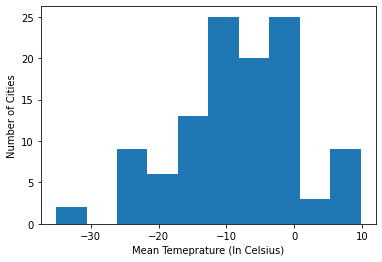

In [119]:
plt.hist(single_day_stats['MEAN_TEMPERATURE'])
plt.xlabel('Mean Temeprature (In Celsius)')
plt.ylabel('Number of Cities')
plt.show()

### Other interesting pattern you may witness as part of your solution.

1. The average temperature in the north is high compared to the southern side of Canada.
2. Population and temperature are highly correlated. With the increase in temperature, we observed an increase in population and vice-versa.
3. 61% of the population is living below 0°C in Winter.

### Any tradeoffs that you made and justify why.

We had a problem in data standardization which means our latitude and longitude values were not exact  with their decimal values. So, I multiplied both latitude and longitude by 10 and converted it into integers. This means I have only taken into account first digit after decimal. This may result in error if two cities are on almost same latitude or longitude.

### How will you change your approach if we were to scale this to a larger dataset?

1. I believe there are efficient way of manipulating dataframes. What I am doing now might work for our dataset but it may take lots of time for larger dataset.
2. We are using all of the columns which may not be necessary for analysis and thus we can load only the columns we need.

### Correlate info

In [120]:
# profiling
profile = ProfileReport(urban_climate_df, title="Pandas Profiling Report")

In [121]:
profile